<a href="https://colab.research.google.com/github/Sarah-0405/Bachelorarbeit_/blob/main/Cluster_Analysis_Zensus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install pypalettes
!pip install contextily==1.2.0


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 366.0/366.0 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 46.3 MB/s eta 0:00:00


In [3]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
import contextily as ctx
from sklearn.cluster import KMeans
from shapely.geometry import Polygon
from shapely.ops import cascaded_union
from IPython import get_ipython
from IPython.display import display


# einzelne Variablen auf Karte visualisieren

In [5]:
Noerdlingen_df = pd.read_csv("/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/NOERDLINGEN_neu_merged.csv")
Kempten_df = pd.read_csv("/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/KEMPTEN_neu_merged_2.csv")
Ingolstadt_df = pd.read_csv("/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/INGOLSTADT_neu_merged_2.csv")

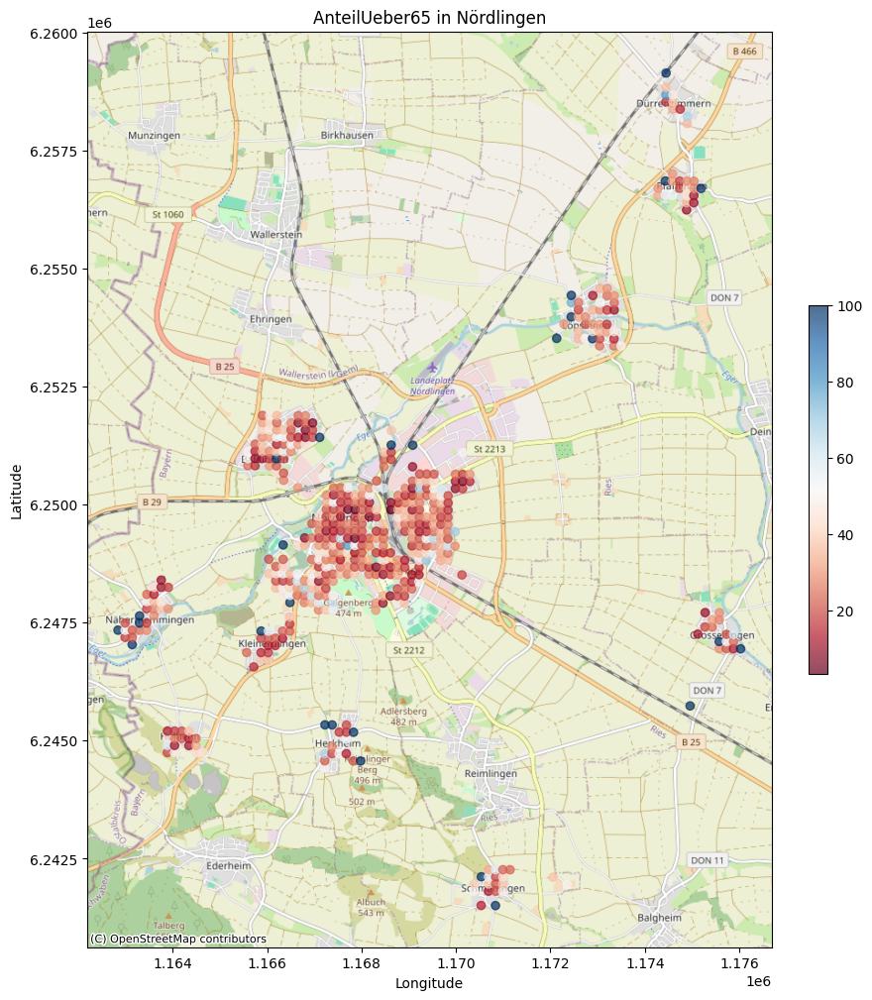

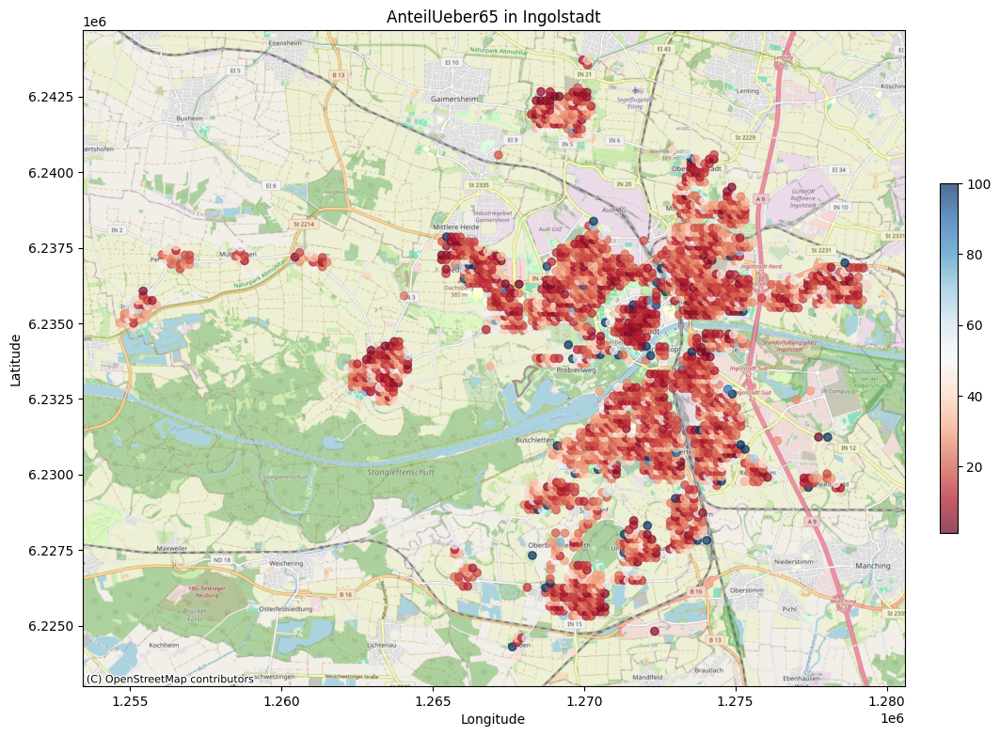

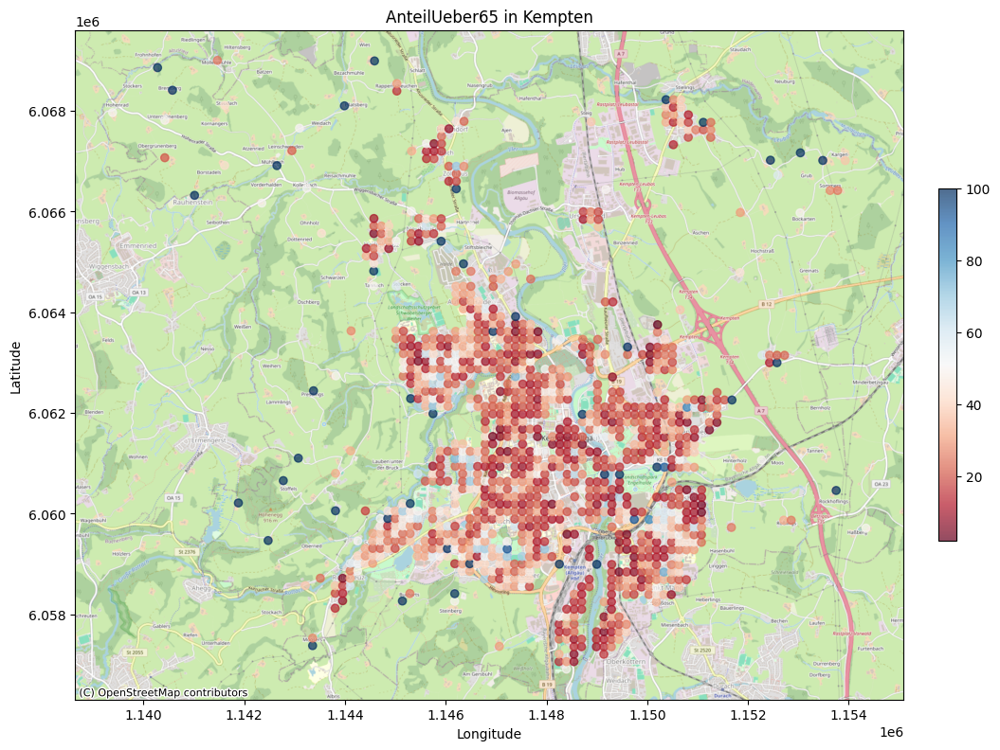

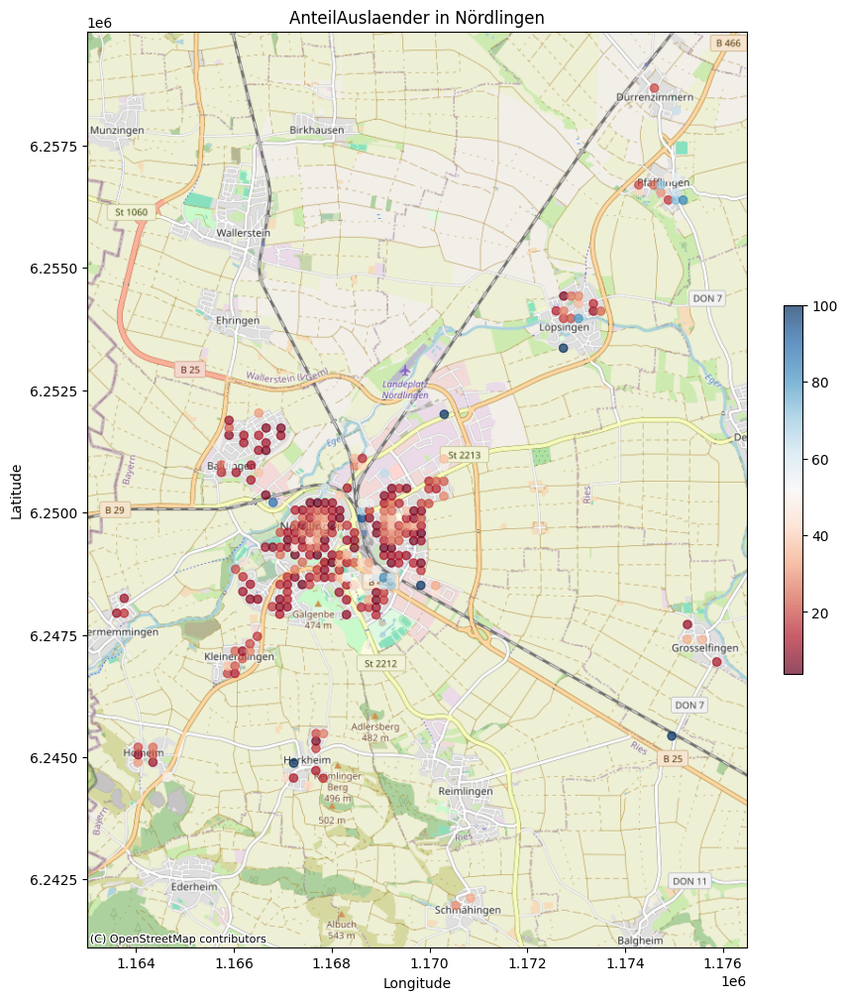

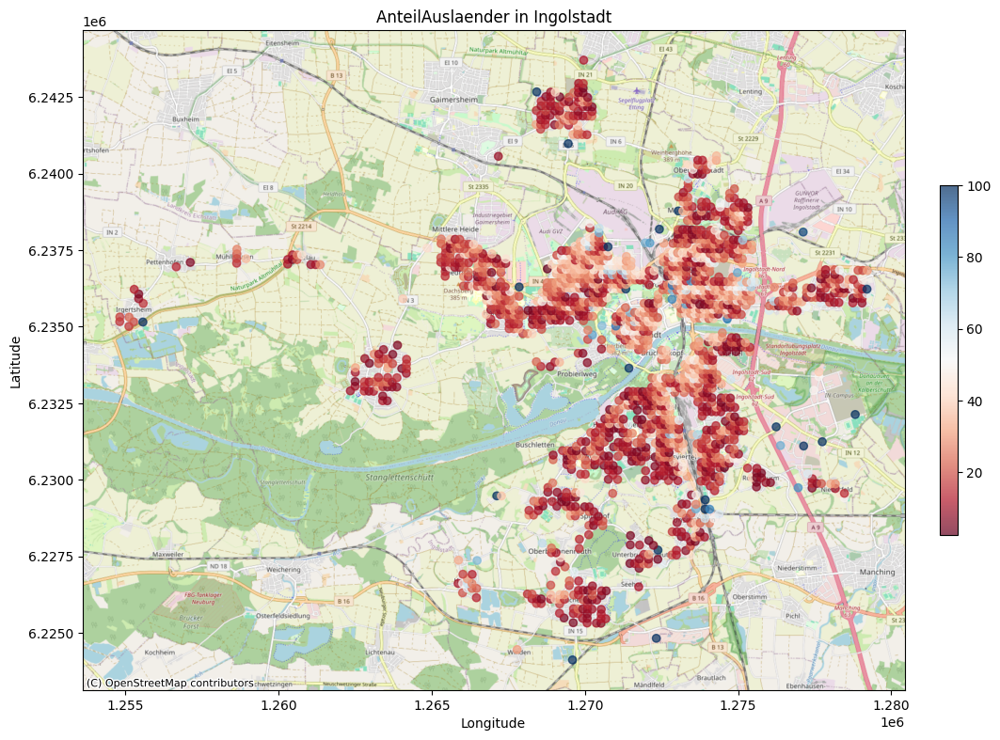

...

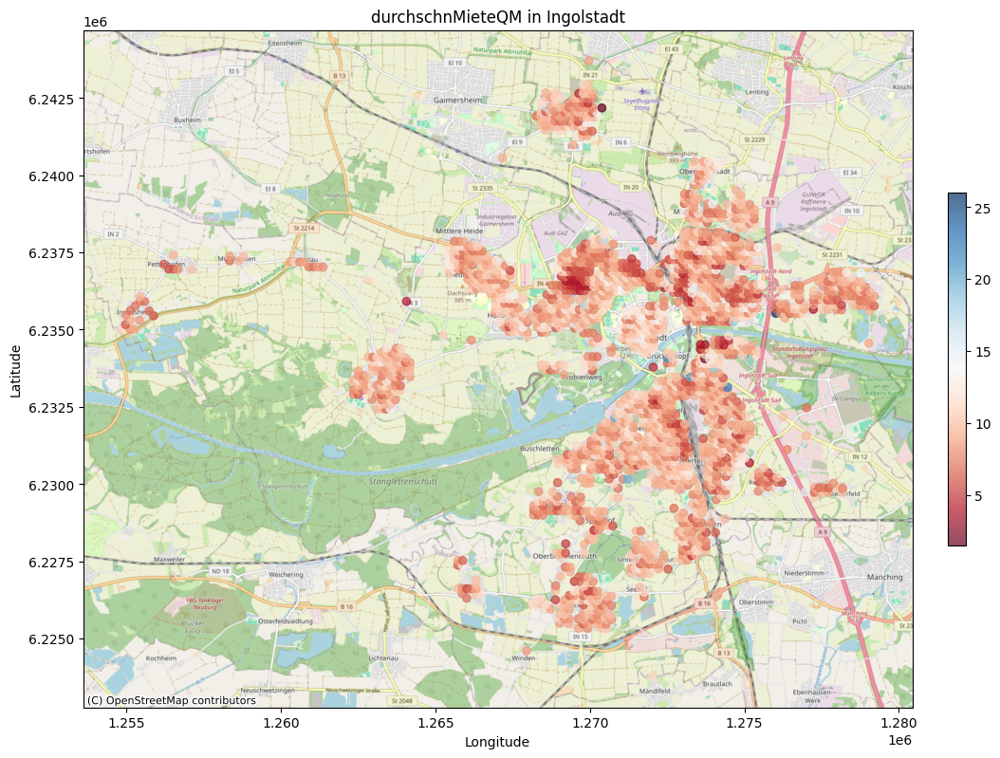

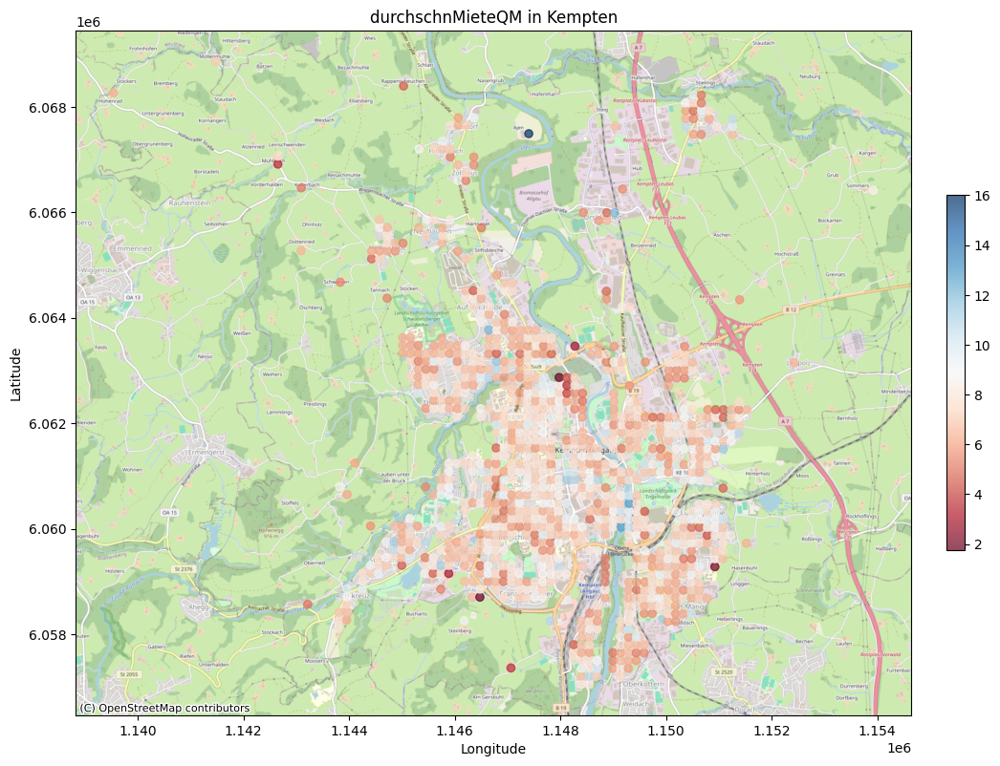

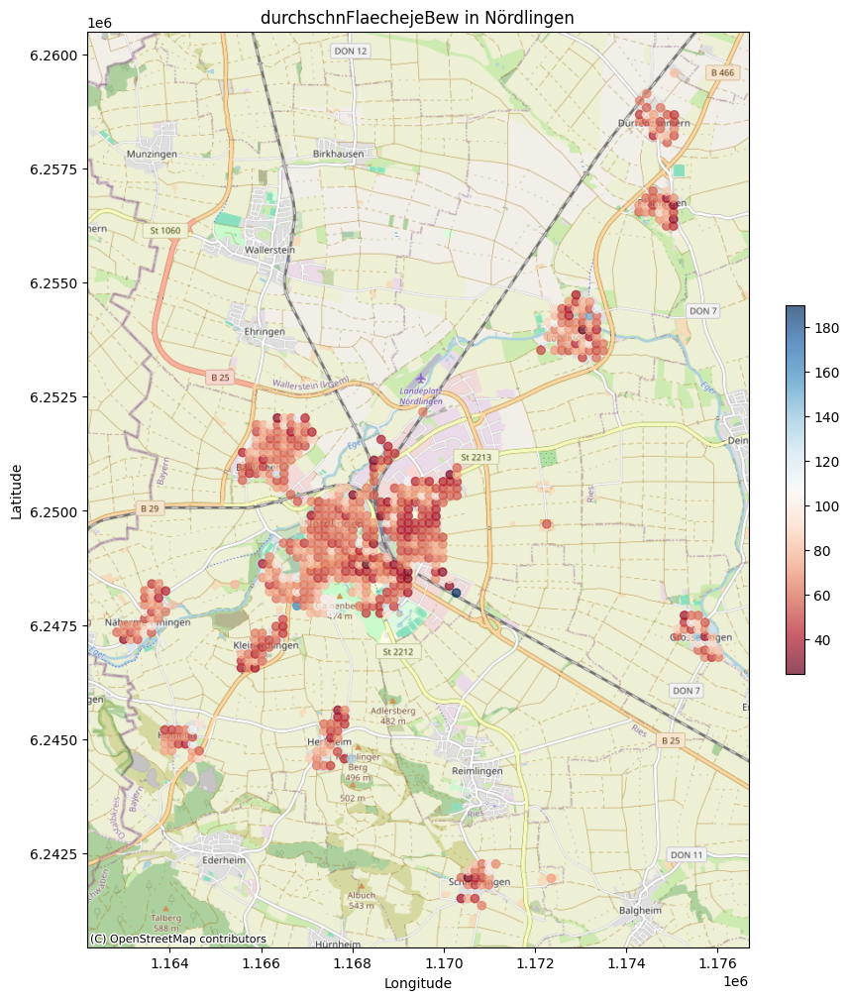

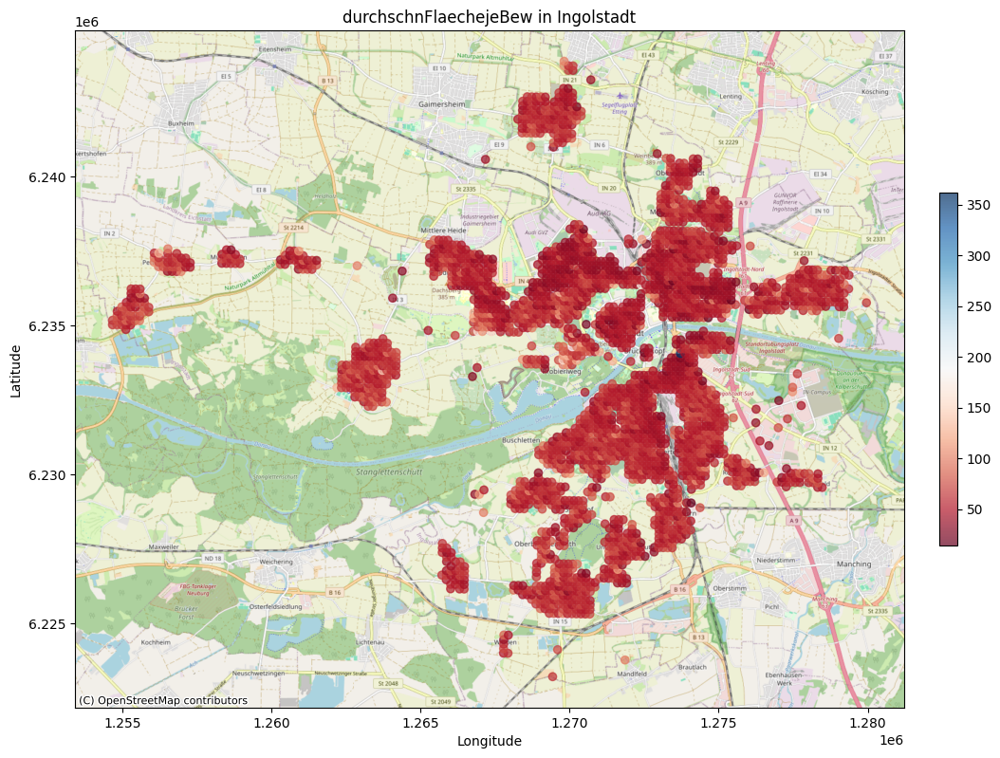

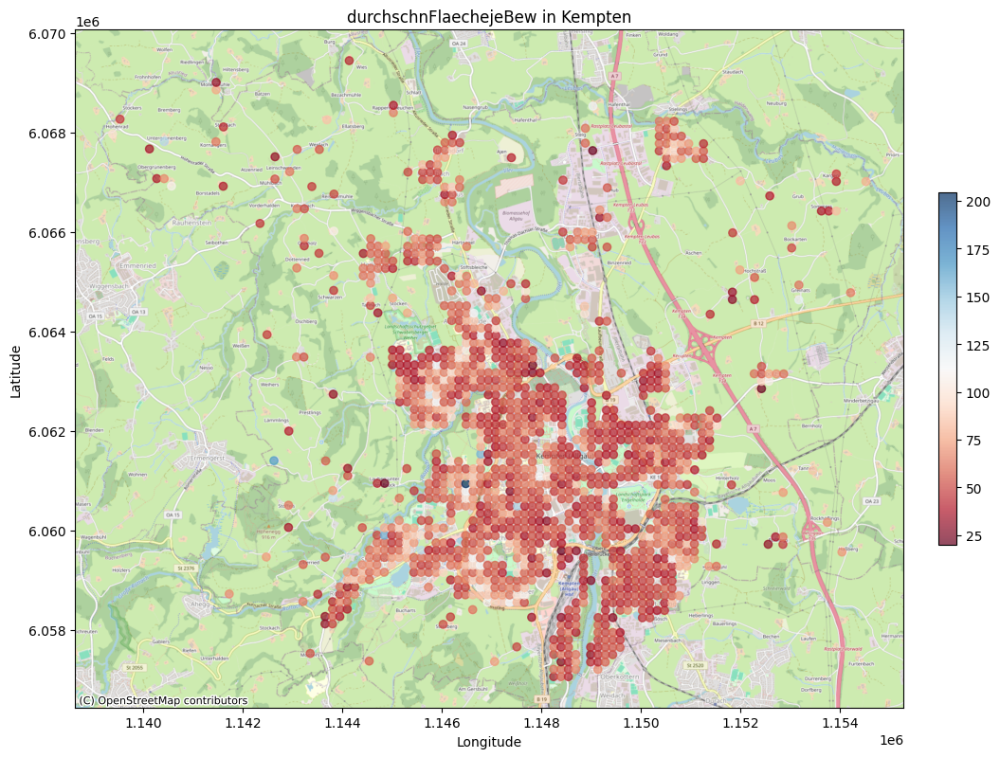

In [6]:
# Funktion zur Visualisierung einer Variable
def visualisiere_variable(gdf, variable, titel):
    """
    Visualisiert die räumliche Verteilung einer Variable auf einer OSM-Karte.

    Args:
        gdf: GeoDataFrame mit den Daten.
        variable: Name der zu visualisierenden Spalte.
        titel: Titel der Karte.
    """

    # 1. Projiziere das GeoDataFrame auf Web Mercator (EPSG:3857) für die OSM-Karte
    gdf = gdf.to_crs(epsg=3857)

    # 2. Erstelle die Karte
    fig, ax = plt.subplots(figsize=(12, 12))

    # 3. Plotte die Variable and store the return value
    #    The return value is a collection of artists and is a mappable
    plot = gdf.plot(column=variable, cmap='RdBu', legend=False, ax=ax, alpha=0.7)
    # create a colorbar using the 'plot' variable's collection
    fig.colorbar(plot.collections[0], ax=ax, fraction=0.02, pad=0.04)

    # 4. Füge den OSM-Hintergrund hinzu
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

    # 5. Setze Titel und Achsenbeschriftungen
    ax.set_title(titel)
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # 6. Zeige die Karte an
    plt.show()


# Erstelle GeoDataFrames für Nördlingen, Ingolstadt und Kempten
# und transformiere sie direkt zum OSM-Koordinatensystem
Noerdlingen_gdf = gpd.GeoDataFrame(
    Noerdlingen_df,
    geometry=gpd.points_from_xy(Noerdlingen_df.x_mp_100m, Noerdlingen_df.y_mp_100m),
    crs="EPSG:3035"
).to_crs(epsg=3857)  # Transformation zum OSM-Koordinatensystem
Ingolstadt_gdf = gpd.GeoDataFrame(
    Ingolstadt_df,
    geometry=gpd.points_from_xy(Ingolstadt_df.x_mp_100m, Ingolstadt_df.y_mp_100m),
    crs="EPSG:3035"
).to_crs(epsg=3857)  # Transformation zum OSM-Koordinatensystem
Kempten_gdf = gpd.GeoDataFrame(
    Kempten_df,
    geometry=gpd.points_from_xy(Kempten_df.x_mp_100m, Kempten_df.y_mp_100m),
    crs="EPSG:3035"
).to_crs(epsg=3857)  # Transformation zum OSM-Koordinatensystem

# Definiere die zu visualisierenden Variablen
variablen = ['AnteilUeber65', 'AnteilAuslaender', 'Anteil_unter10', 'durchschnMieteQM', 'durchschnFlaechejeBew']

# Visualisiere die Variablen für jeden Datensatz
for variable in variablen:
    visualisiere_variable(Noerdlingen_gdf, variable, f'{variable} in Nördlingen')
    visualisiere_variable(Ingolstadt_gdf, variable, f'{variable} in Ingolstadt')
    visualisiere_variable(Kempten_gdf, variable, f'{variable} in Kempten')

# alle 3 Städte zusammen Clustern

In [7]:
# 1. Datenvorbereitung
df = pd.concat([Noerdlingen_df, Kempten_df, Ingolstadt_df]) # Städte werden untereinander gelistet
features = ['AnteilUeber65', 'AnteilAuslaender', 'durchschnFlaechejeBew', 'Durchschnittsalter',
             'durchschnMieteQM', 'Anteil_unter10', 'Einwohner']
X = df[features]
imputer = KNNImputer(n_neighbors=5)
X_imputed = imputer.fit_transform(X)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)


In [8]:
print(X.columns)
print(X.head)

Index(['AnteilUeber65', 'AnteilAuslaender', 'durchschnFlaechejeBew',
       'Durchschnittsalter', 'durchschnMieteQM', 'Anteil_unter10',
       'Einwohner'],
      dtype='object')
<bound method NDFrame.head of       AnteilUeber65  AnteilAuslaender  durchschnFlaechejeBew  \
0               NaN               NaN                  65.00   
1               NaN               NaN                    NaN   
2               NaN               NaN                  39.04   
3             13.64               NaN                  78.77   
4               NaN               NaN                  48.23   
...             ...               ...                    ...   
3123          14.29               NaN                  54.63   
3124            NaN               NaN                 107.92   
3125           9.52              11.9                  61.30   
3126          40.00               NaN                  67.85   
3127            NaN               NaN                 102.25   

      Durchschnittsalt

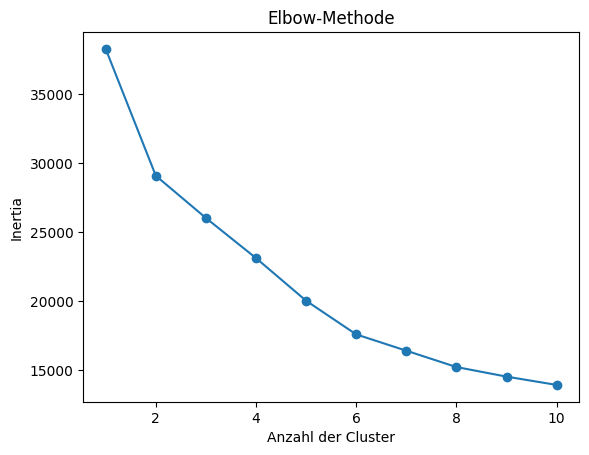

In [9]:
# 2. Bestimmung der optimalen Clusteranzahl (Elbow-Methode)
inertia = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Elbow-Methode')
plt.xlabel('Anzahl der Cluster')
plt.ylabel('Inertia')
plt.show()

In [10]:
# 3. K-Means Clustering (mit 5 Clustern)
kmeans = KMeans(n_clusters=5, random_state=42)
cluster_labels = kmeans.fit_predict(X_scaled) # Get cluster labels


In [11]:
# 4. Clusterzugehörigkeiten zum ursprünglichen DataFrame hinzufügen
df['cluster'] = cluster_labels # Add cluster labels to original DataFrame


In [12]:
# 5. Auswertung und Visualisierung
print(df['cluster'].value_counts())
print(df.head(10)) # Access desired columns

cluster
1    1884
3    1845
4     814
2     516
0     407
Name: count, dtype: int64
                   GITTER_ID_100m  x_mp_100m  y_mp_100m  \
0  CRS3035RES100mN2854400E4359000    4359050    2854450   
1  CRS3035RES100mN2854500E4358400    4358450    2854550   
2  CRS3035RES100mN2854500E4358700    4358750    2854550   
3  CRS3035RES100mN2854500E4358800    4358850    2854550   
4  CRS3035RES100mN2854500E4358900    4358950    2854550   
5  CRS3035RES100mN2854500E4359000    4359050    2854550   
6  CRS3035RES100mN2854600E4358800    4358850    2854650   
7  CRS3035RES100mN2854600E4359000    4359050    2854650   
8  CRS3035RES100mN2854700E4358700    4358750    2854750   
9  CRS3035RES100mN2854700E4358800    4358850    2854750   

                  geometry  AnteilUeber65  AnteilAuslaender  \
0  POINT (4359050 2854450)            NaN               NaN   
1  POINT (4358450 2854550)            NaN               NaN   
2  POINT (4358750 2854550)            NaN               NaN   
3  POINT (4358

In [ ]:
df['cluster'] = df['cluster'] + 1
df = df.drop(columns=['Unter10', 'Insgesamt_Bevoelkerung'])

In [ ]:
df.to_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv', index=False)


In [13]:
alle_staedte_cluster = pd.read_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv')


<frozen importlib._bootstrap>:1047: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()


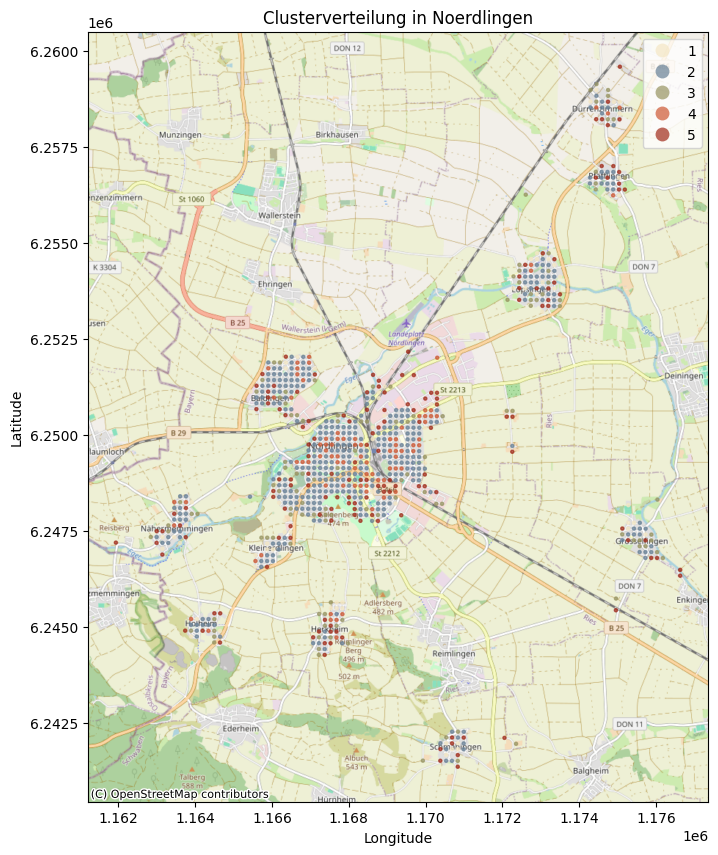

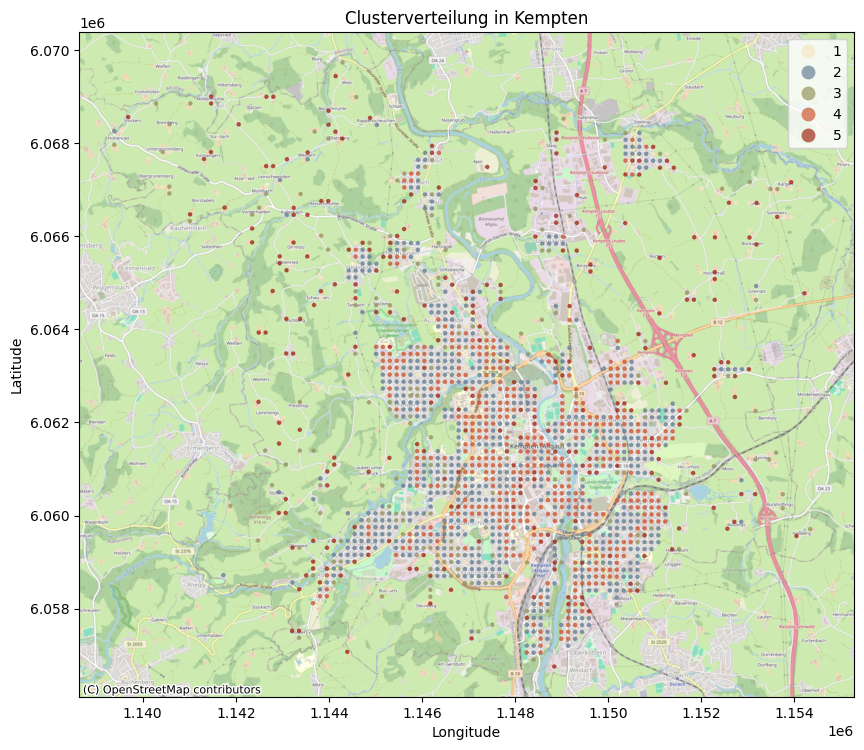

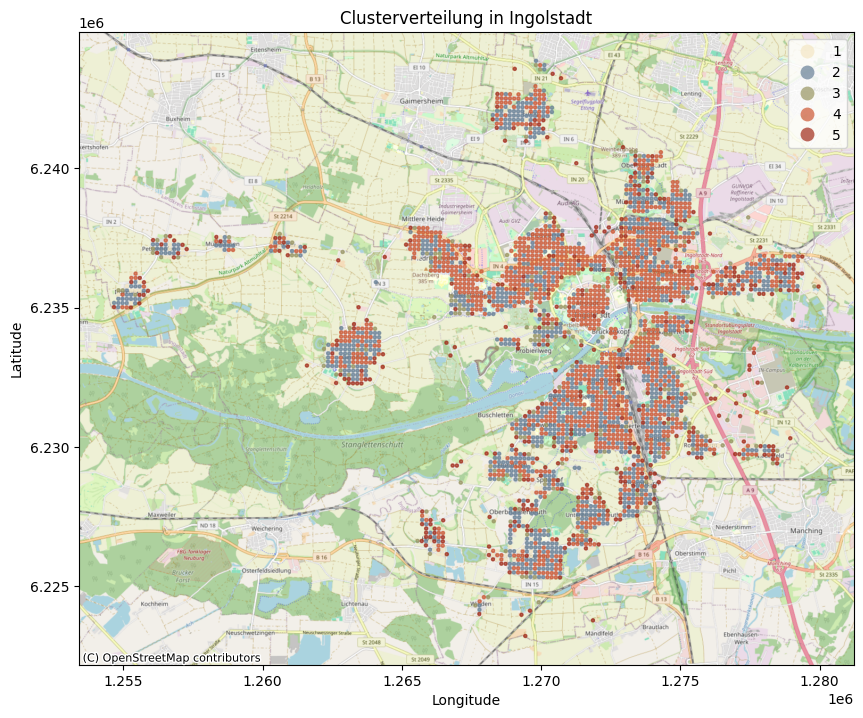

In [14]:
# 1. Daten aus der CSV-Datei laden
alle_staedte_cluster = pd.read_csv('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv')

from pypalettes import load_cmap
cmap = load_cmap("ArcticGates")

# 2. Städte und deren Daten definieren
cities = {
    "Noerdlingen": alle_staedte_cluster.iloc[:len(Noerdlingen_df)],  # Daten für Nördlingen
    "Kempten": alle_staedte_cluster.iloc[len(Noerdlingen_df):len(Noerdlingen_df) + len(Kempten_df)],  # Daten für Kempten
    "Ingolstadt": alle_staedte_cluster.iloc[len(Noerdlingen_df) + len(Kempten_df):],  # Daten für Ingolstadt
}

# 3. Für jede Stadt eine Karte erstellen
for city_name, city_data in cities.items():
    # GeoDataFrame erstellen
    gdf = gpd.GeoDataFrame(
        city_data,
        geometry=gpd.points_from_xy(city_data.x_mp_100m, city_data.y_mp_100m),
        crs="EPSG:3035"
    ).to_crs(epsg=3857)

    # Karte erstellen
    fig, ax = plt.subplots(figsize=(10, 10))
    gdf.plot(column='cluster', categorical=True, legend=True, ax=ax, alpha=0.7, markersize=5, cmap=cmap) # cmap hinzugefügt
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title(f'Clusterverteilung in {city_name}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    plt.show()

In [ ]:
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns=features, index=[f'Cluster {i}' for i in range(5)])
display(centroid_df)

,AnteilUeber65,AnteilAuslaender,durchschnFlaechejeBew,Durchschnittsalter,durchschnMieteQM,Anteil_unter10,Einwohner
Cluster 0,-0.137101,0.432810,-0.317917,-1.217318,-0.103339,2.413229,-0.568744
Cluster 1,0.012125,-0.583323,0.241219,0.386018,-0.367590,-0.173478,-0.154140
Cluster 2,2.204856,1.010913,1.464804,1.835348,-0.556786,-0.762539,-0.765672
Cluster 3,-0.689077,-0.432667,-0.571097,-0.431451,0.535638,0.189118,0.840409
Cluster 4,0.200990,1.471761,-0.037101,-0.473258,0.045267,-0.747885,-0.772718


Zentroid-Output zeigt jetzt Verteilung der einzelnen Variablen im jeweiligen Cluster, anhand davon kann jetzt interpretiert werden


in Gitterzellen umwandeln und visualisieren

In [17]:
alle_staedte_cluster = gpd.read_file('/content/drive/MyDrive/Daten BA /erstellte Dateien mit colab/alle_staedte_cluster.csv')
# Definiere das Koordinatensystem, falls es nicht in der CSV-Datei enthalten ist:
alle_staedte_cluster.crs = 'epsg:3035'

# Convert 'x_mp_100m' and 'y_mp_100m' columns to numeric
alle_staedte_cluster['x_mp_100m'] = pd.to_numeric(alle_staedte_cluster['x_mp_100m'])
alle_staedte_cluster['y_mp_100m'] = pd.to_numeric(alle_staedte_cluster['y_mp_100m'])

def create_grid_cell(row):
    """Erstellt ein Polygon (Rechteck) basierend auf den Koordinaten des Mittelpunkts."""
    x = row['x_mp_100m']
    y = row['y_mp_100m']
    # Erstelle die Eckpunkte des Rechtecks:
    # Annahme: x und y sind in einem projizierten Koordinatensystem, wo die Einheiten Meter sind
    p1 = (x - 50, y + 50)  # Links oben
    p2 = (x + 50, y + 50)  # Rechts oben
    p3 = (x + 50, y - 50)  # Rechts unten
    p4 = (x - 50, y - 50)  # Links unten
    # Erstelle das Polygon:
    polygon = Polygon([p1, p2, p3, p4])
    return polygon

#Create geometry column. This will convert the DataFrame to a GeoDataFrame.
alle_staedte_cluster['geometry'] = alle_staedte_cluster.apply(create_grid_cell, axis=1)
#Setting the crs to make sure it's a GeoDataFrame. This was previously set after reading the file.
alle_staedte_cluster = gpd.GeoDataFrame(alle_staedte_cluster, geometry='geometry', crs='epsg:3035')

<frozen importlib._bootstrap>:1047: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:1047: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen

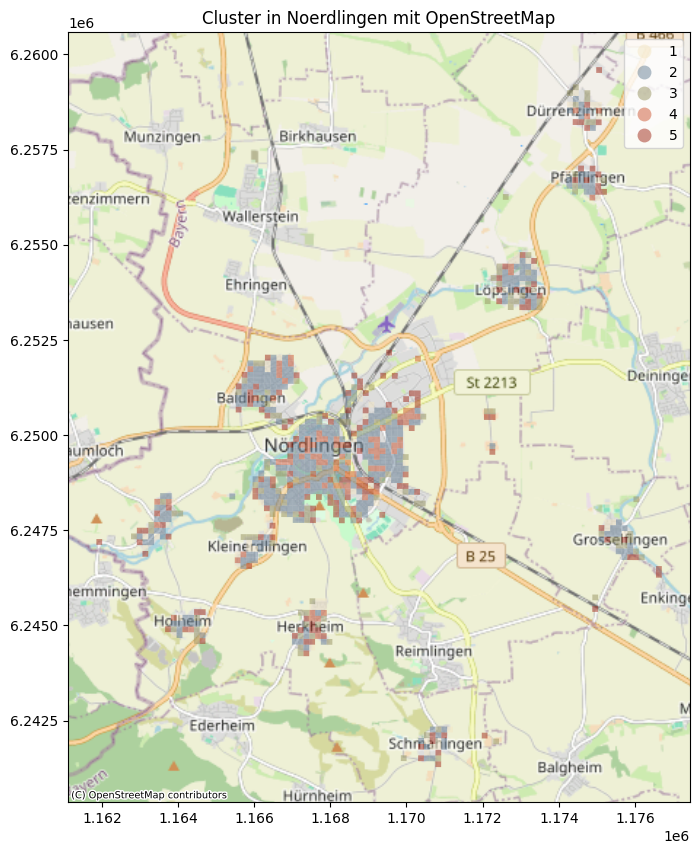

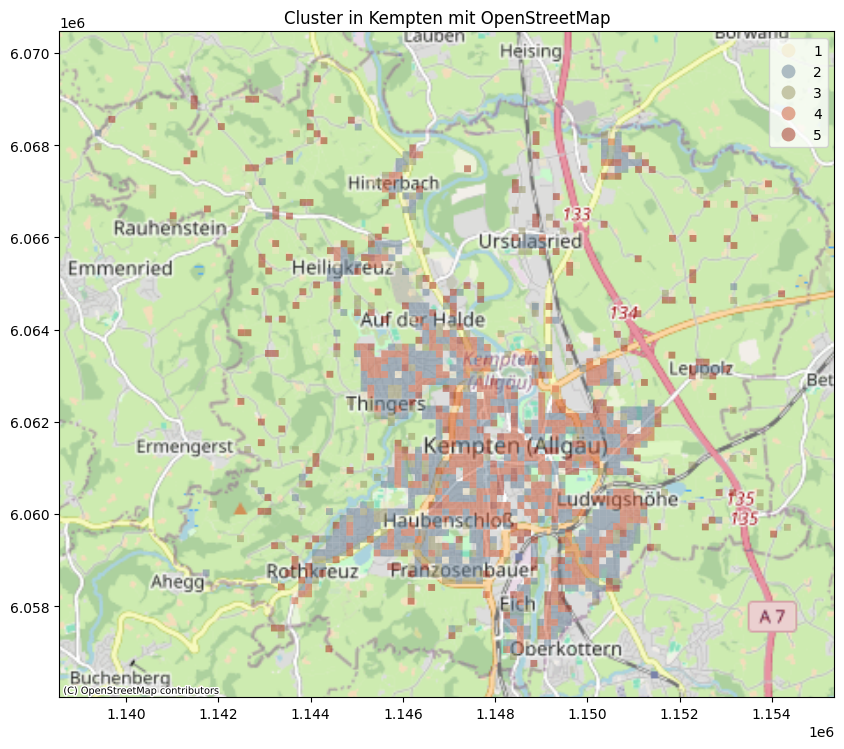

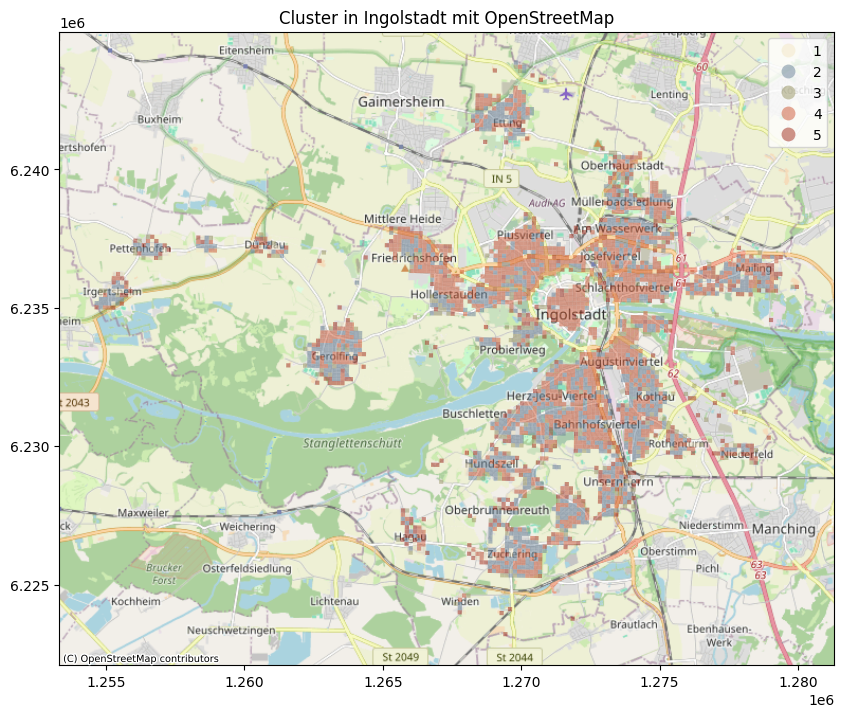

In [19]:
# Annahme: Noerdlingen_df, Kempten_df, Ingolstadt_df und alle_staedte_cluster sind bereits geladen

# Importiere die benötigten Bibliotheken
import contextily as ctx
import matplotlib.pyplot as plt
import geopandas as gpd

# Definiere das CRS für die Basemap (z.B. Web Mercator)
basemap_crs = "EPSG:3857"

# Erstelle ein Dictionary, das die Gitter-IDs den Städten zuordnet
stadt_gitter_ids = {}
for stadt_df, stadt_name in [(Noerdlingen_df, "Noerdlingen"), (Kempten_df, "Kempten"), (Ingolstadt_df, "Ingolstadt")]:
    stadt_gitter_ids[stadt_name] = stadt_df["GITTER_ID_100m"].unique().tolist()

# Definiere die Basemap-Provider
basemap_providers = {
    "OpenStreetMap": ctx.providers.OpenStreetMap.Mapnik,
}

from pypalettes import load_cmap
cmap = load_cmap("ArcticGates")

# Schleife über die Städte und Basemap-Provider
for stadt_name, gitter_ids in stadt_gitter_ids.items():
    for provider_name, provider_source in basemap_providers.items():
        # Erstelle eine Figure und ein Axes-Objekt
        fig, ax = plt.subplots(figsize=(10, 10))

        # Extrahiere die Cluster für die aktuelle Stadt anhand der Gitter-IDs
        stadt_cluster = alle_staedte_cluster[alle_staedte_cluster["GITTER_ID_100m"].isin(gitter_ids)]

        # Konvertiere stadt_cluster in ein GeoDataFrame
        stadt_cluster = gpd.GeoDataFrame(stadt_cluster, geometry='geometry', crs=alle_staedte_cluster.crs)

        # Projiziere die Cluster in das CRS der Basemap
        stadt_cluster = stadt_cluster.to_crs(basemap_crs)

        # Plotte die Cluster auf der Karte mit den eindeutigen Farben
        stadt_cluster.plot(ax=ax, column="cluster", legend=True, alpha=0.5,
                          edgecolor="black", linewidth=0, cmap=cmap)

        # Füge Basemap hinzu (verwende den Bounding Box der Stadt)
        bbox = stadt_cluster.total_bounds
        ctx.add_basemap(ax, crs=basemap_crs, source=provider_source,
                         attribution_size=7, zoom=12)

        # Setze den Titel der Karte
        ax.set_title(f"Cluster in {stadt_name} mit {provider_name}")

        # Zeige die Karte
        plt.show()

In [ ]:
from pypalettes import load_cmap
cmap = load_cmap("ArcticGates")
cmap = load_cmap("Antique")
cmap = load_cmap("Demuth")
cmap = load_cmap("GrandCanyon")

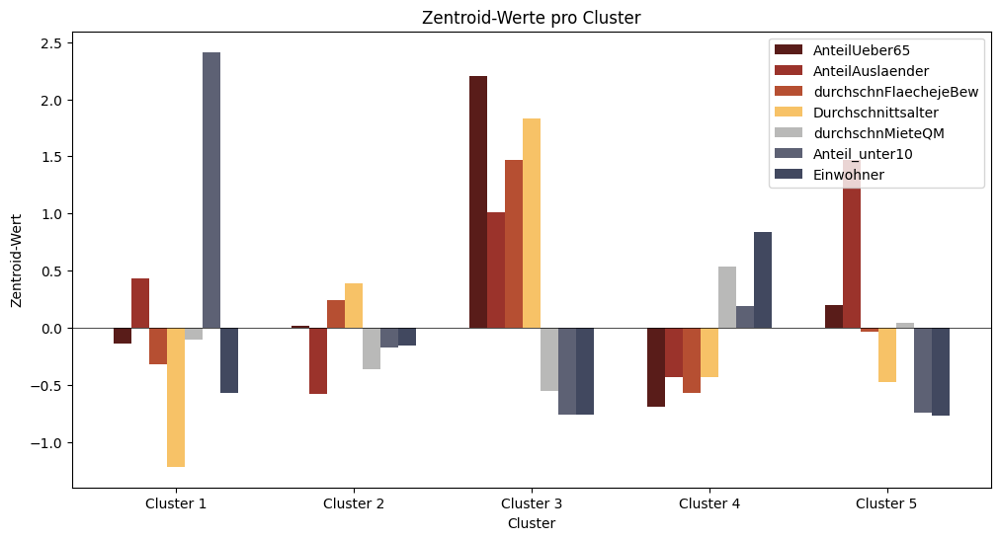

In [ ]:
# Balkendiagramm aus Zentroid-Daten

# Zentroid-Daten aus dem DataFrame extrahieren
cluster_names = [f'Cluster {i+1}' for i in range(5)]  # Clusternamen von 1-5
variables = centroid_df.columns  # Variablennamen
centroid_values = centroid_df.values  # Zentroid-Werte

# Lade die Farbpalette
cmap = load_cmap("Demuth")

# Farben für die Variablen definieren (anstatt der vorherigen Liste)
colors = [cmap(i / len(variables)) for i in range(len(variables))]

# Breite der Balken und Positionen festlegen
bar_width = 0.1
index = np.arange(len(cluster_names))

# Balkendiagramm erstellen
fig, ax = plt.subplots(figsize=(12, 6))
for i, variable in enumerate(variables):
    ax.bar(index + i * bar_width, centroid_values[:, i], bar_width, label=variable, color=colors[i])

# Achsenbeschriftungen und Legende hinzufügen
ax.set_xlabel('Cluster')
ax.set_ylabel('Zentroid-Wert')
ax.set_xticks(index + bar_width * (len(variables) -1) / 2)  # Zentrierte x-Achsenbeschriftungen
ax.set_xticklabels(cluster_names)
ax.legend()

# Horizontale Linie bei y=0 einzeichnen
ax.axhline(0, color='black', linewidth=0.5)  # Ändere Farbe und Linienstärke nach Bedarf


# Titel hinzufügen
plt.title('Zentroid-Werte pro Cluster')

# Diagramm anzeigen
plt.show()


Variablen noch umbenennen, Schriftart ändern,...